<a href="https://colab.research.google.com/github/Byeon-MJ/DL_Computer_Vision/blob/main/Age_Gender_Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
# DNN module 다운로드
!git clone https://github.com/habom2310/People-tracking-with-Age-and-Gender-detection.git

Cloning into 'People-tracking-with-Age-and-Gender-detection'...
remote: Enumerating objects: 82, done.
remote: Counting objects: 100% (8/8), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 82 (delta 1), reused 0 (delta 0), pack-reused 74
Unpacking objects: 100% (82/82), done.


In [3]:
# # 필요한 파일만 복사
# !cp /content/People-tracking-with-Age-and-Gender-detection/age_gender_models/age_net.caffemodel /content/gdrive/MyDrive/CV/Age and Gender Recognition
# !cp /content/People-tracking-with-Age-and-Gender-detection/age_gender_models/deploy_age.prototxt /content/gdrive/MyDrive/CV/Age and Gender Recognition
# !cp /content/People-tracking-with-Age-and-Gender-detection/age_gender_models/gender_net.caffemodel /content/gdrive/MyDrive/CV/Age and Gender Recognition
# !cp /content/People-tracking-with-Age-and-Gender-detection/age_gender_models/deploy_gender.prototxt /content/gdrive/MyDrive/CV/Age and Gender Recognition

In [4]:
# # 다운받았던 파일 제거
# !rm -r /content/People-tracking-with-Age-and-Gender-detection

In [5]:
# 모듈 임포트
import glob
import dlib
import cv2
from google.colab.patches import cv2_imshow

In [6]:
# 나이 분류 구간 정의
age_list = ['(0-2)', '(4-6)', '(8-12)', '(15-20)', '(25-32)', '(38-43)', '(48-53)', '(60-100)']

# 성별 구분 정의
gender_list = ['Male', 'Female']

# 얼굴 감지하는 detector 정의
detector = dlib.get_frontal_face_detector()

# 나이 감지하는 detector 정의
age_detector = cv2.dnn.readNetFromCaffe('/content/People-tracking-with-Age-and-Gender-detection/age_gender_models/deploy_age.prototxt',
                                        '/content/People-tracking-with-Age-and-Gender-detection/age_gender_models/age_net.caffemodel')

# 성별을 감지하는 detector 정의
gender_detector = cv2.dnn.readNetFromCaffe('/content/People-tracking-with-Age-and-Gender-detection/age_gender_models/deploy_gender.prototxt',
                                           '/content/People-tracking-with-Age-and-Gender-detection/age_gender_models/gender_net.caffemodel')

In [7]:
# 이미지 디렉토리의 리스트 불러온다
img_list = glob.glob('/content/gdrive/MyDrive/CV/Age and Gender Recognition/images/*.jpg')

In [8]:
# 이미지 폴더의 파일 수 확인
print('image folder files count : %s' % len(img_list))

image folder files count : 18


Number of faces detected: 1


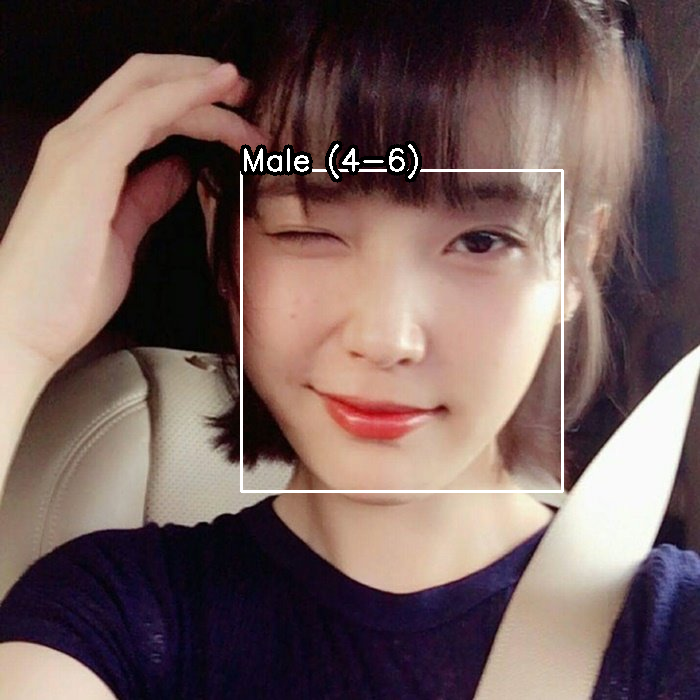




Number of faces detected: 2


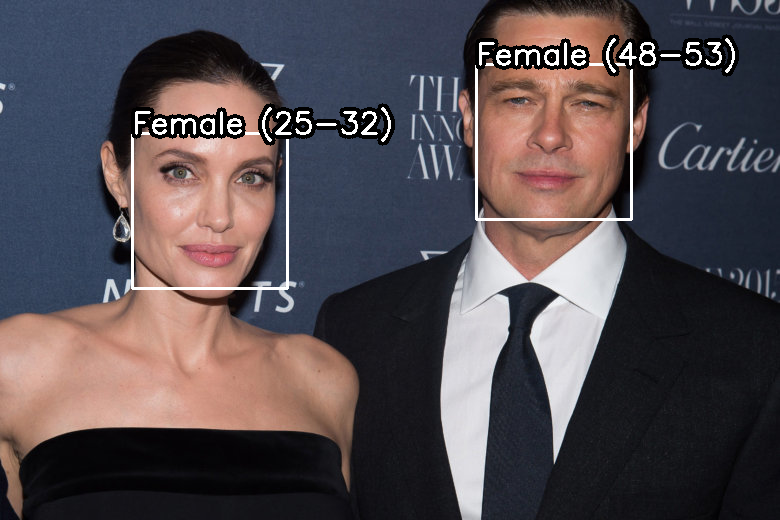




Number of faces detected: 1


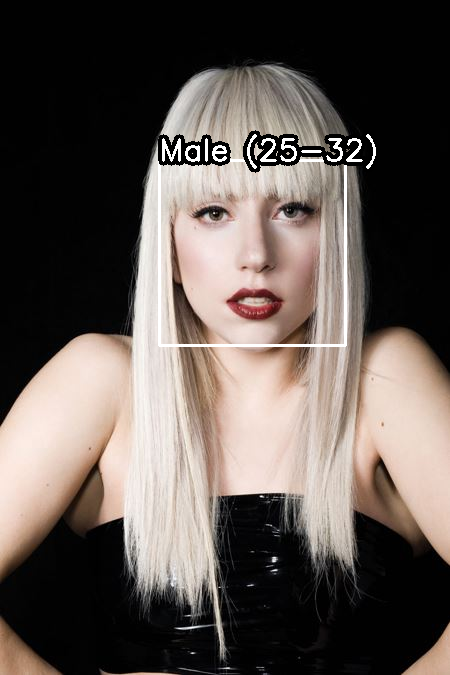




Number of faces detected: 1


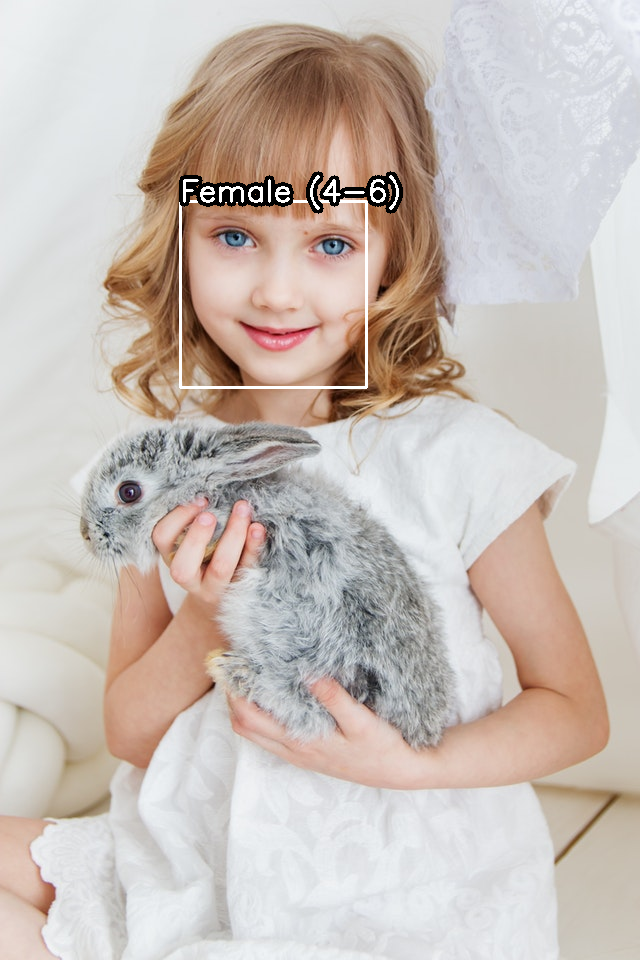




Number of faces detected: 1


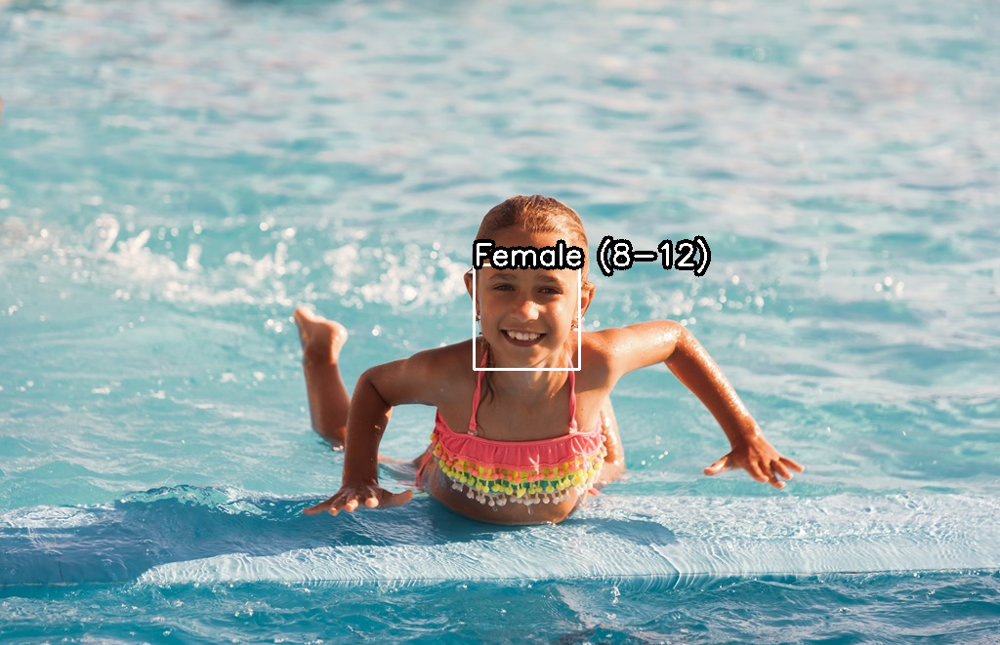




Number of faces detected: 3


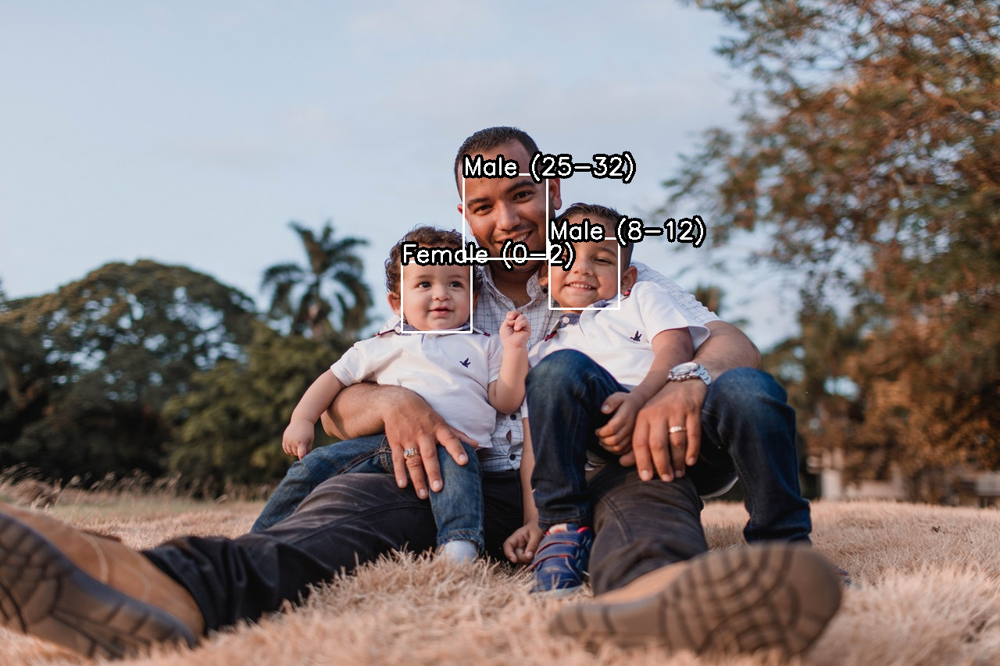




Number of faces detected: 1


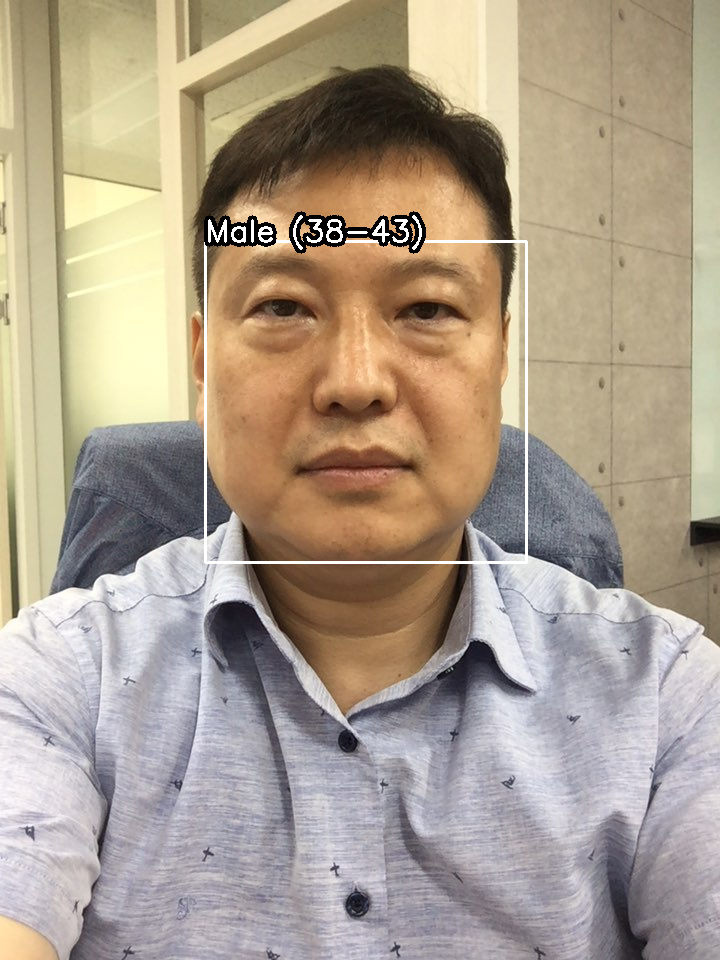




Number of faces detected: 4


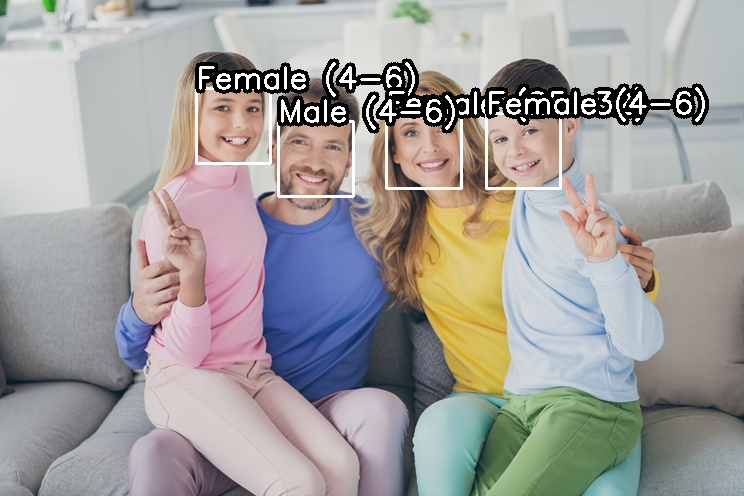




Number of faces detected: 1


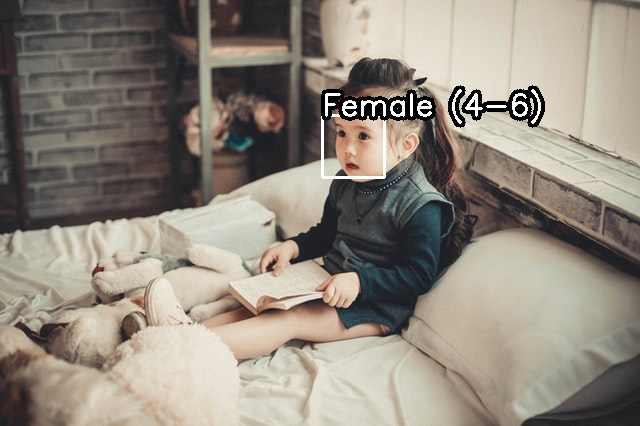




Number of faces detected: 1


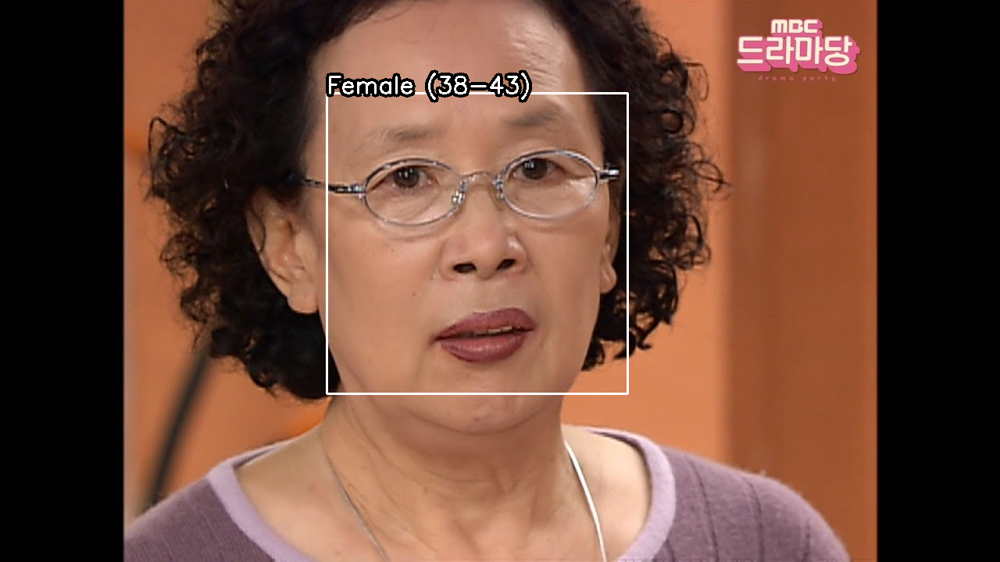




Number of faces detected: 1


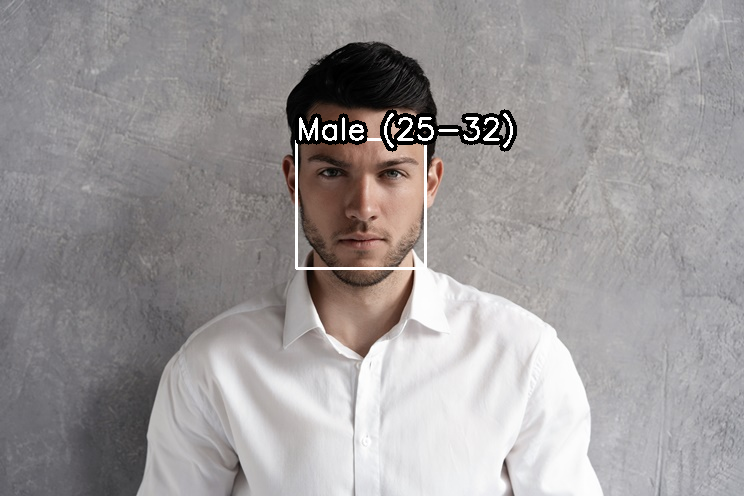




Number of faces detected: 5


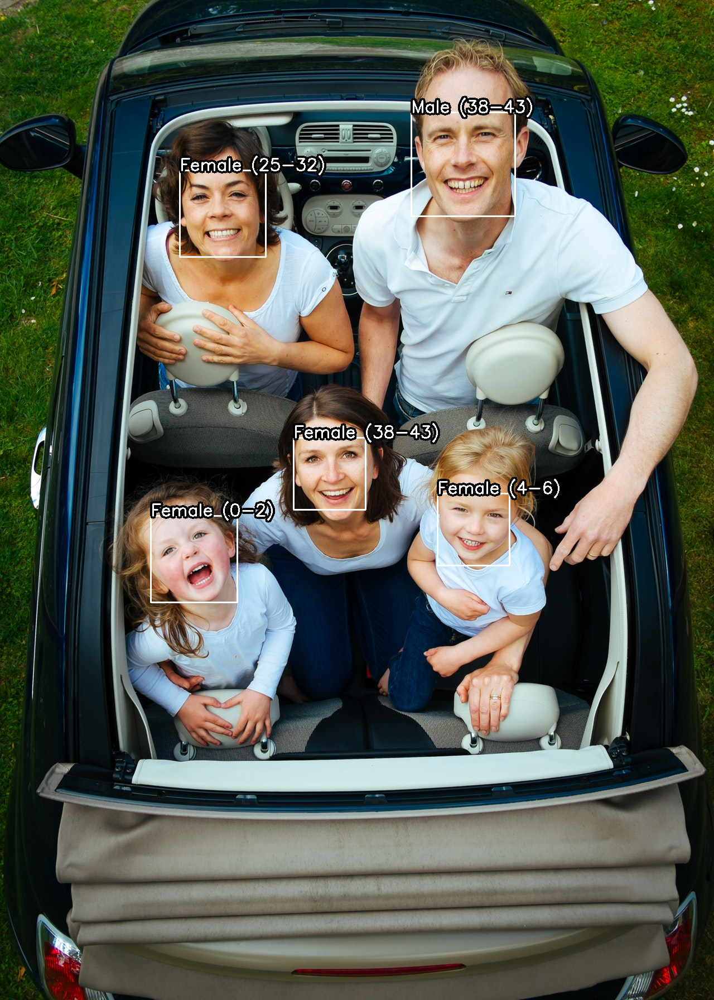




Number of faces detected: 1


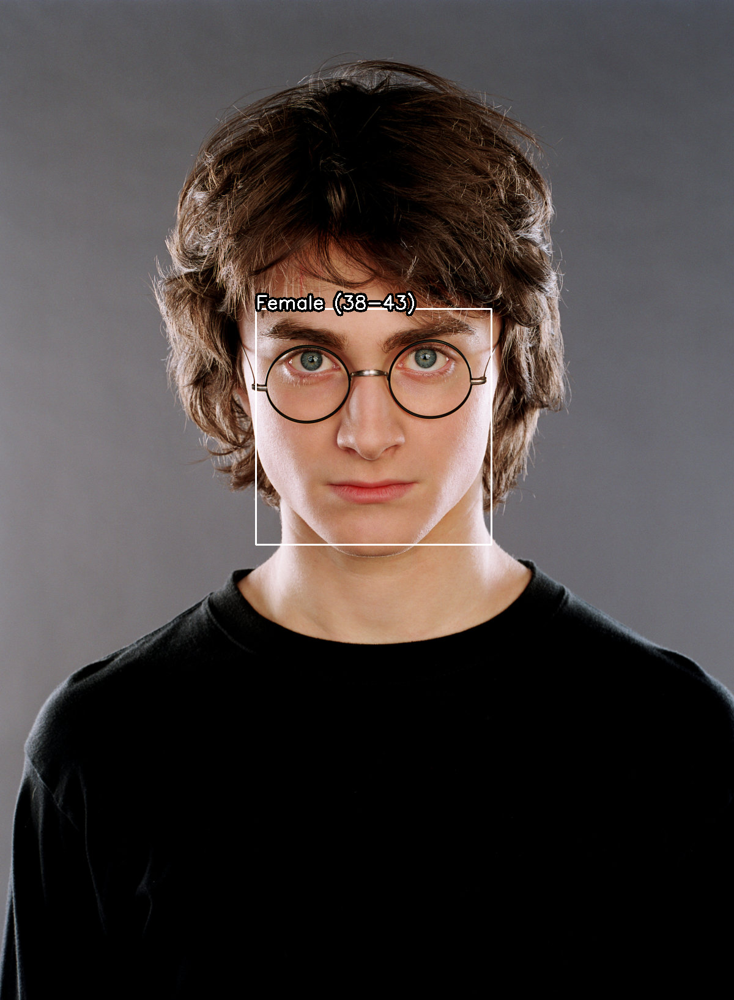




Number of faces detected: 1


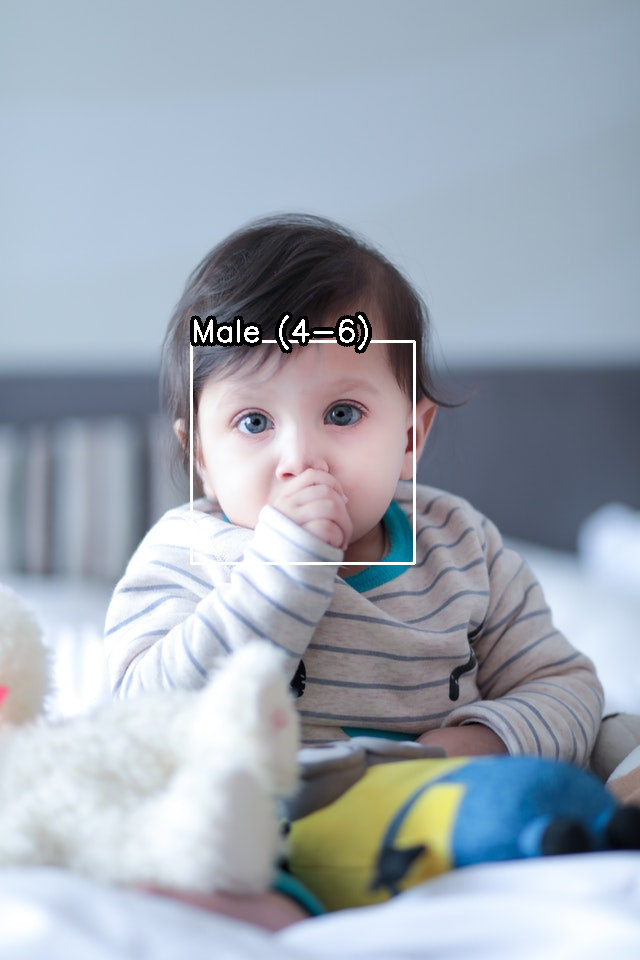




Number of faces detected: 7


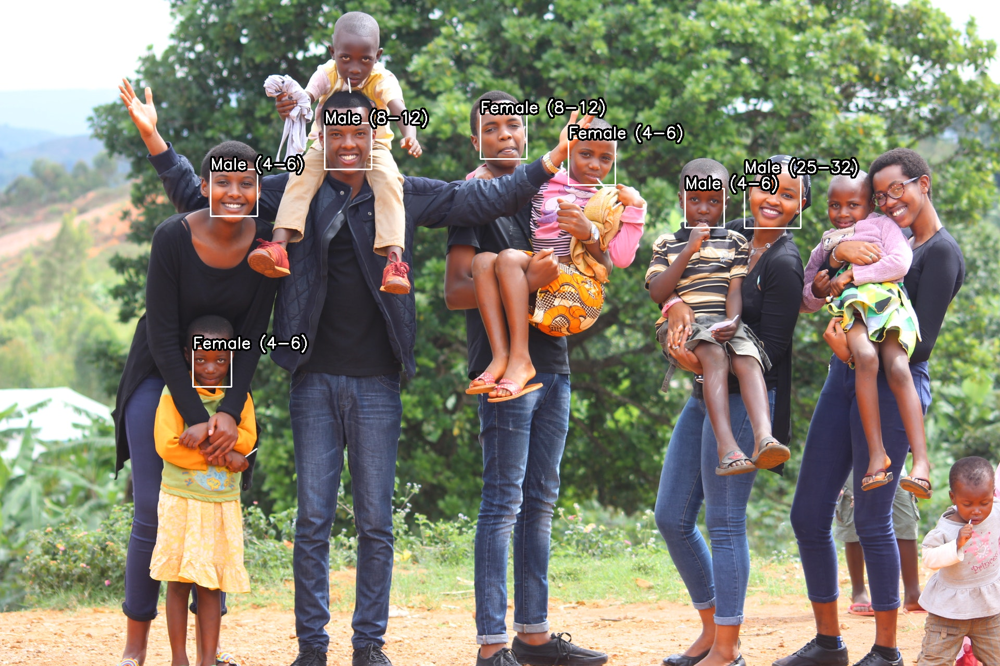




Number of faces detected: 1


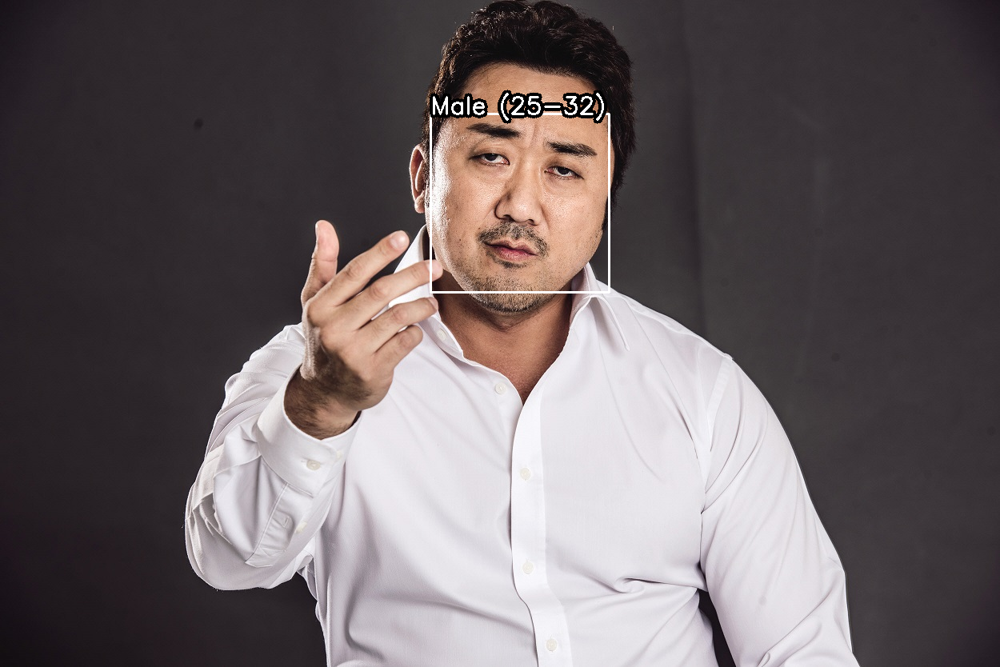




Number of faces detected: 1


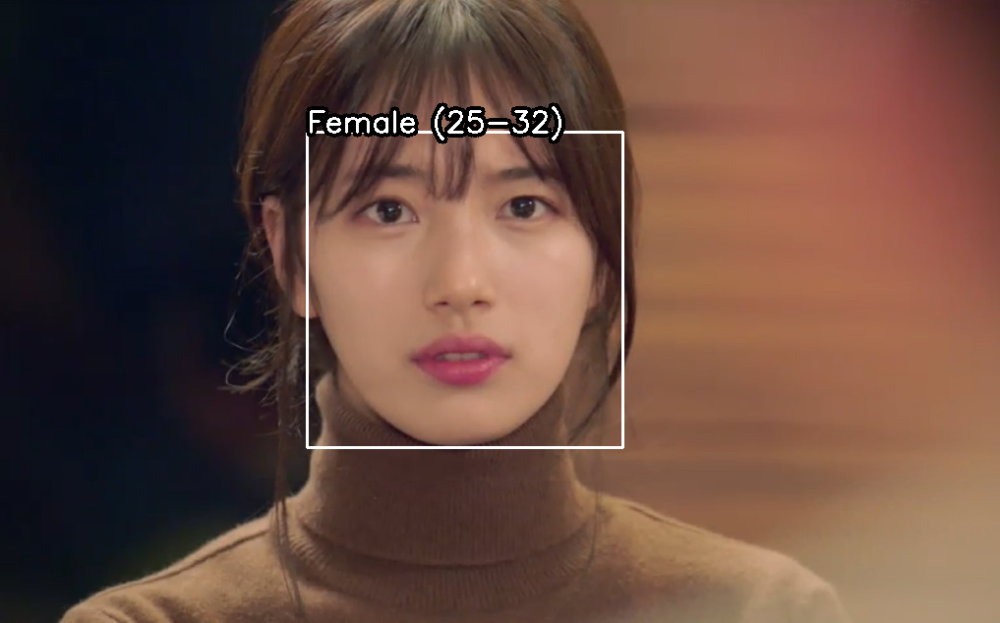




Number of faces detected: 1


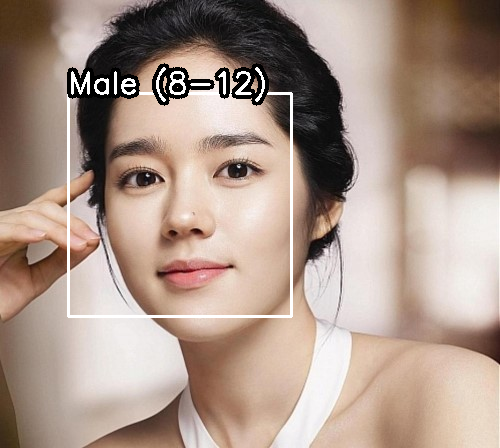

In [11]:
for img_path in img_list:
    # 이미지 로드
    image = cv2.imread(img_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # detector에 의해 얼굴 감지
    faces = detector(gray, 1)
    print(f'Number of faces detected: {len(faces)}')

    for face in faces:
        # boxing 좌표를 구한다.
        x1, y1, x2, y2 = face.left(), face.top(), face.right(), face.bottom()

        # 얼굴 영역만 copy
        face_img = image[y1:y2, x1:x2].copy()

        # !! param 분석할것 !!
        blob = cv2.dnn.blobFromImage(face_img, scalefactor = 1, size = (227, 227),
                                     mean = (78.4263377603, 87.7689143744, 114.895847746), swapRB = False, crop = False)
        
        # predict age
        age_detector.setInput(blob)
        age_preds = age_detector.forward()
        age = age_list[age_preds[0].argmax()]

        # predict gender
        gender_detector.setInput(blob)
        gender_preds = gender_detector.forward()
        gender = gender_list[gender_preds[0].argmax()]

        cv2.rectangle(image, (x1, y1), (x2, y2), (255, 255, 255), 2)
        overlay_text = '%s %s' % (gender, age)
        cv2.putText(image, overlay_text, org=(x1, y1), fontFace=cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale=1, color=(0, 0, 0), thickness=10)
        cv2.putText(image, overlay_text, org=(x1, y1), fontFace=cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale=1, color=(255,255,255), thickness=2)
    
    # 결과 이미지 Display
    cv2_imshow(image)
    print('\n\n')